In [5]:

# One common type of visualization in data science is that of geographic data. Python can create maps 
# that display bar charts as a 3D visual plot, based on longitue and latitude coordinates. Very cool!!


,city,city_ascii,state_id,state_name,county_fips,county_name,lat,lng,population,density,source,military,incorporated,timezone,ranking,zips,id,popl_div_100
0,New York,New York,NY,New York,36081,Queens,40.6943,-73.9249,18972871,10768.2,shape,False,True,America/New_York,1,11229 11226 11225 11224 11223 11221 11220 1138...,1840034016,189728.71
1,Los Angeles,Los Angeles,CA,California,6037,Los Angeles,34.1141,-118.4068,12121244,3267.6,shape,False,True,America/Los_Angeles,1,90291 90293 90292 91316 91311 90035 90034 9003...,1840020491,121212.44
2,Chicago,Chicago,IL,Illinois,17031,Cook,41.8375,-87.6866,8595181,4576.6,shape,False,True,America/Chicago,1,60018 60649 60641 60640 60643 60642 60645 6064...,1840000494,85951.81
3,Miami,Miami,FL,Florida,12086,Miami-Dade,25.7840,-80.2101,5711945,4945.7,shape,False,True,America/New_York,1,33128 33129 33125 33126 33127 33149 33144 3314...,1840015149,57119.45
4,Dallas,Dallas,TX,Texas,48113,Dallas,32.7935,-96.7667,5668165,1522.2,shape,False,True,America/Chicago,1,75287 75098 75234 75254 75251 75252 75253 7503...,1840019440,56681.65
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30839,Ironville,Ironville,PA,Pennsylvania,42013,Blair,40.6586,-78.2155,0,59.2,shape,False,False,America/New_York,3,16686,1840152922,0.00
30840,Newkirk,Newkirk,NM,New Mexico,35019,Guadalupe,35.0635,-104.2715,0,0.0,shape,False,False,America/Denver,3,88417,1840024978,0.00
30841,Falcon Village,Falcon Village,TX,Texas,48427,Starr,26.5652,-99.1341,0,38.9,shape,False,False,America/Chicago,3,78545,1840018314,0.00
30842,Hidden Lakes,Hidden Lakes,OH,Ohio,39117,Morrow,40.5479,-82.7632,0,18.6,shape,False,False,America/New_York,3,43338,1840153068,0.00


In [11]:

import pandas as pd
import pydeck as pdk

# Load the CSV file into a DataFrame and keep only the specified columns:
df_us = pd.read_csv('C:\\Users\\uscities.csv')

# Scale the population column for easier comparison to Australia:
df_us['popl_div_100'] = (df_us['population'] / 100)  

display(df_us)


,city,city_ascii,state_id,state_name,county_fips,county_name,lat,lng,population,density,source,military,incorporated,timezone,ranking,zips,id,popl_div_100
0,New York,New York,NY,New York,36081,Queens,40.6943,-73.9249,18972871,10768.2,shape,False,True,America/New_York,1,11229 11226 11225 11224 11223 11221 11220 1138...,1840034016,189728.71
1,Los Angeles,Los Angeles,CA,California,6037,Los Angeles,34.1141,-118.4068,12121244,3267.6,shape,False,True,America/Los_Angeles,1,90291 90293 90292 91316 91311 90035 90034 9003...,1840020491,121212.44
2,Chicago,Chicago,IL,Illinois,17031,Cook,41.8375,-87.6866,8595181,4576.6,shape,False,True,America/Chicago,1,60018 60649 60641 60640 60643 60642 60645 6064...,1840000494,85951.81
3,Miami,Miami,FL,Florida,12086,Miami-Dade,25.7840,-80.2101,5711945,4945.7,shape,False,True,America/New_York,1,33128 33129 33125 33126 33127 33149 33144 3314...,1840015149,57119.45
4,Dallas,Dallas,TX,Texas,48113,Dallas,32.7935,-96.7667,5668165,1522.2,shape,False,True,America/Chicago,1,75287 75098 75234 75254 75251 75252 75253 7503...,1840019440,56681.65
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,New Llano,New Llano,LA,Louisiana,22115,Vernon,31.0970,-93.2767,2472,401.0,shape,False,True,America/Chicago,3,71446 71461,1840017111,24.72
9996,Carlisle-Rockledge,Carlisle-Rockledge,AL,Alabama,1055,Etowah,34.1140,-86.1191,2472,60.3,shape,False,True,America/Chicago,4,35956 35954,1840037805,24.72
9997,Marmora,Marmora,NJ,New Jersey,34009,Cape May,39.2594,-74.6570,2471,484.3,shape,False,False,America/New_York,3,8223,1840081012,24.71
9998,Holcomb,Holcomb,KS,Kansas,20055,Finney,37.9859,-100.9936,2471,739.1,shape,False,True,America/Chicago,3,67851,1840007523,24.71


In [12]:

# Build the map layer:    
layer = pdk.Layer(type='ColumnLayer',
                  data=df_us,
                  get_position=['lng', 'lat'],
                  get_elevation='population',
                  auto_highlight=True,
                  elevation_scale=0.03,
                  pickable=True,
                  get_fill_color=['population', 255],
                  coverage=5)

# Set the view parameters:
view_state = pdk.ViewState(longitude=-95, 
                           latitude=36,
                           zoom=3.8,
                           min_zoom=3,
                           max_zoom=15,
                           pitch=45.0,
                           bearing=0)

# Render the map:
r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r.to_html('usa_popl.html')


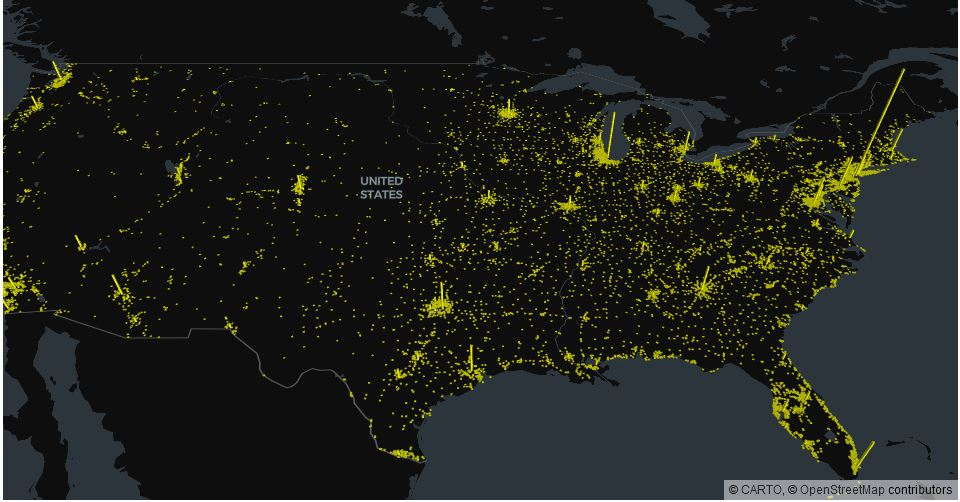

In [15]:

from IPython.display import Image
Image(filename='C:\\Users\\1.JPG', width=600)


In [13]:

# Build the map layer:
layer = pdk.Layer(type='ColumnLayer', 
                  data=df_us,
                  get_position=['lng', 'lat'],
                  get_elevation='density',
                  auto_highlight=True,
                  elevation_scale=20,
                  pickable=True,
                  get_fill_color=['density', 220],
                  coverage=2)

# Set the view parameters:
view_state = pdk.ViewState(longitude=-95,
                           latitude=36,
                           zoom=3.8,
                           min_zoom=3,
                           max_zoom=15,
                           pitch=45.0,
                           bearing=0)

# Render the map:
r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r.to_html('usa_density.html')


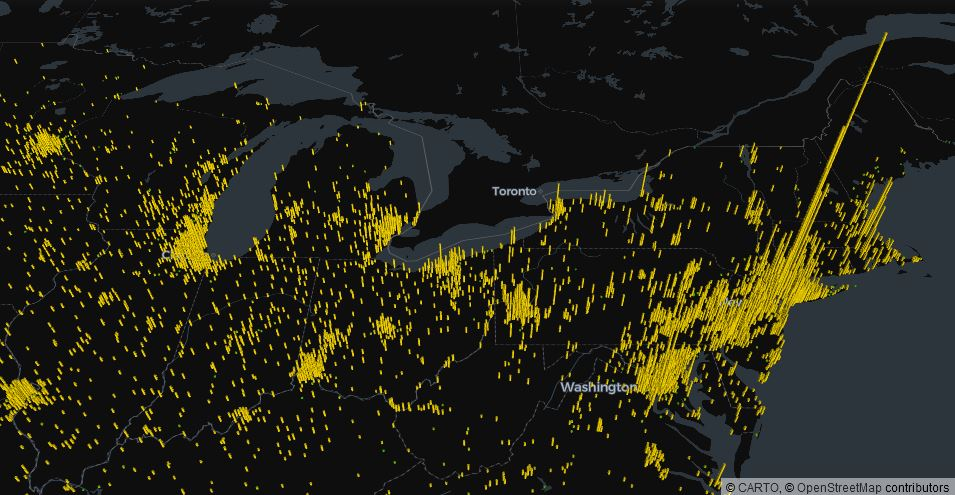

In [14]:

from IPython.display import Image
Image(filename='C:\\2.JPG', width=600)


In [9]:

# Data source:
# https://simplemaps.com/data/us-cities

# logic:
# https://towardsdatascience.com/say-goodbye-to-flat-maps-with-pydeck-5ce440177bcd
